In [ ]:
!git clone https://github.com/Medhansh404/GAN_Project.git

Cloning into 'GAN_Project'...
remote: Enumerating objects: 5993, done.
remote: Counting objects: 100% (5993/5993), done.
remote: Compressing objects: 100% (5794/5794), done.
remote: Total 5993 (delta 198), reused 5993 (delta 198), pack-reused 0 (from 0)
Receiving objects: 100% (5993/5993), 30.13 MiB | 12.41 MiB/s, done.
Resolving deltas: 100% (198/198), done.
Updating files: 100% (6003/6003), done.


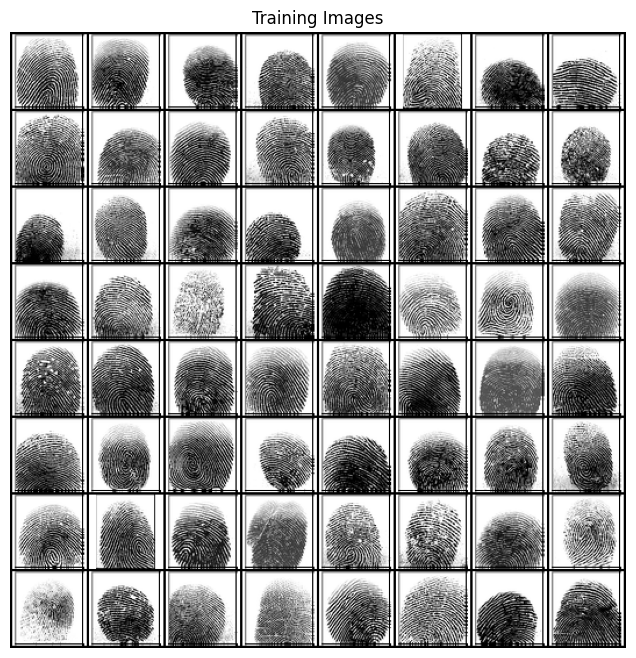

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


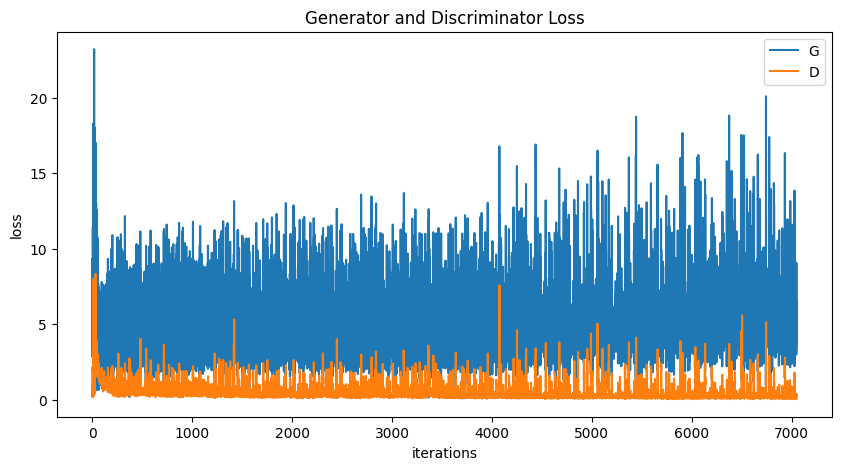

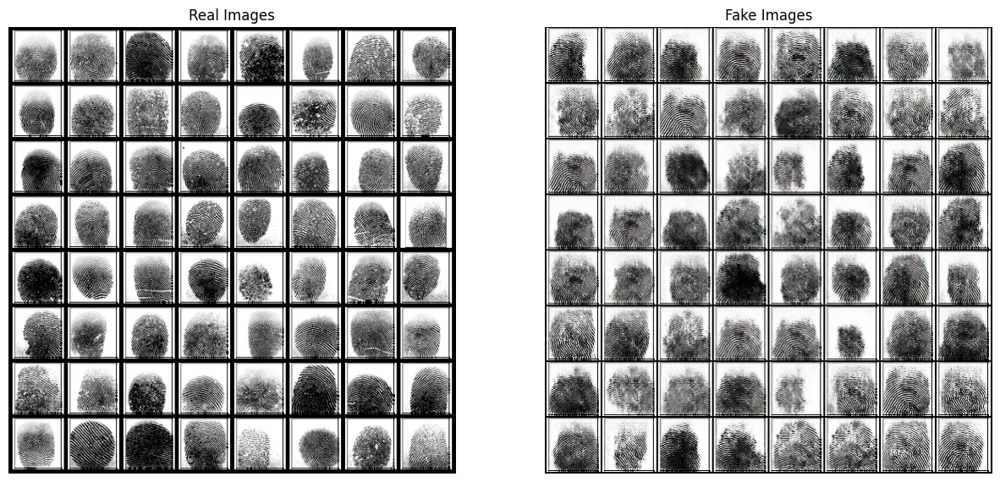

In [ ]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
from torchvision.utils import save_image
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

SEED = 1234
random.seed(SEED)
torch.manual_seed(SEED)

# path to training images
dataroot = "GAN_Project/data"

output_dir = "GAN_Project/generated_images"

# training batch size
batch_size = 128

# image dimension pixels
image_size = 64

# color channels
nc = 3

# latent vector size for generator input
nz = 100

# feature size generator
ngf = 64

# feature size discriminator
ndf = 64

# training runs ("epochs")
num_epochs = 150

# learning rate, from paper
lr = 0.0002

# param for Adam optimizer
beta1 = 3e-4

# initializes weights per DCGAN paper
def init_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class Generator(nn.Module):
    """
    Helper class for the generator module

    We have four convolutional stages, with normalizations between each
    Individual kernels are 4x4, with other dimensions/strides scaled
    accordingly.

    The rectified linear activation function ReLU allows fast training while
    avoiding problems associated with sigmoids, etc (vanishing gradients)
    The final application of tanh maps the output to [-1, 1] like our
    normalized input images.
    """
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # Input to convolution stage
            # intermediate state (ngf*8) x 4 x 4
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(True),
            # intermediate state (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(True),
            # intermediate state (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
            # intermediate state ngff x 32 x 32
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh(),
            # output state 64 x 64
        )

    def forward(self, inp):
        """
        Feed input data forward to produce an output image
        """
        return self.main(inp)


class Discriminator(nn.Module):
    """
    helper class for the discriminator module

    This operates similarly to the generator, except that now we are
    convolving with the current weights working toward a value judgement at
    the end.
    """
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input size 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state ndf x 32 x 32
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state (ndf*2) x 16 x 16
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state (ndf*4) x 8 x 8
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state (ndf*8) x 4 x 4
            nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, inp):
        """
        Feed input data forward to produce an output classification
        """
        return self.main(inp)

# Data marshalling helpers
dataset = dset.ImageFolder(root=dataroot,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
    ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
shuffle=True, num_workers=2)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Sanity check on dataset
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose( vutils.make_grid(real_batch[0].to(device)[:64],padding=2,normalize=True).cpu(),(1,2,0)))
plt.show()

# Set up networks
generator = Generator().to(device)
generator.apply(init_weights)
print(generator)

discriminator = Discriminator().to(device)
discriminator.apply(init_weights)
print(discriminator)

# Set up feedback optimizers
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1
fake_label = 0

optimizerD = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG= optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))


# Training loop

img = []
G_loss = []
D_loss = []
iters = 0
os.makedirs(output_dir, exist_ok=True)

for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        # Train with known good data

        # zero out gradients
        discriminator.zero_grad()

        # prepare a batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device, dtype=torch.float)

        # feed forward
        output = discriminator(real_cpu).view(-1)

        # compute error and backpropagate
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # Train with known fake data
        # prepare a batch of random data for the latent space
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        # generate batch of fake images
        fake = generator(noise)
        label.fill_(fake_label)

        # feed forward
        output = discriminator(fake.detach()).view(-1)

        #compute error and backpropagate
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake

        optimizerD.step()

        # Train G

        # prepare a batch of random data for the latent space
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        # generate batch of fake images
        fake = generator(noise)

        # zero out gradients
        generator.zero_grad()

        label.fill_(real_label)

        # get feedback from discriminator
        output = discriminator(fake).view(-1)

        #compute error and backpropagate
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()

        optimizerG.step()

        if i % 25 == 0:
            print('Epoch [%d/%d] Batch [%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'% (epoch, num_epochs, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_loss.append(errG.item())
        D_loss.append(errD.item())

        if (iters % 10 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img.append(vutils.make_grid(fake, padding=2, normalize=True))
            print(fake.shape)
            im_tens = fake[0]
            file_name = f"gen_{iters}.png"
            save_image(im_tens, os.path.join(output_dir, file_name))

        iters += 1

# plot loss over time
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss")
plt.plot(G_loss, label='G')
plt.plot(D_loss, label='D')
plt.xlabel('iterations')
plt.ylabel('loss')
plt.legend()
plt.show()

# animate images development in generator
#fig  = plt.figure(figsize=(8,8))
#plt.axis("off")
#ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img]
#ani = animation.ArtistAnimation(fig, ims, interval=1000,repeat_delay=1000,blit=True)
#HTML(ani.to_jshtml())


# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img[-1],(1,2,0)))
plt.show()

# save the optimizer and discriminator state for the demo
torch.save(
    {
        'discriminator_state_dict':discriminator.state_dict(),
        'optimizerD_state_dict':optimizerD.state_dict(),
        'generator_state_dict':generator.state_dict(),
        'optimizerG_state_dict':optimizerG.state_dict()
    },
    'networkStates.pyt'
)

In [ ]:
from pytorch_fid import fid_score

# Paths to real and generated images
real_images_path = "data/real_images"
generated_images_path = "data/generated_images"

# Save generated images
import os
from torchvision.utils import save_image

os.makedirs(generated_images_path, exist_ok=True)
fixed_noise = torch.randn(1000, nz, 1, 1, device=device)  # Generate 1000 images
with torch.no_grad():
    generated_images = generator(fixed_noise)
for i, img in enumerate(generated_images):
    save_image(img, os.path.join(generated_images_path, f"img_{i}.png"), normalize=True)

# Compute FID
fid = fid_score.calculate_fid_given_paths(
    [real_images_path, generated_images_path],
    batch_size=50,
    device=device,
    dims=2048  # Feature dimensions from Inception-v3
)
print(f"FID Score: {fid}")

ModuleNotFoundError: No module named 'pytorch_fid'

Training discriminator...


<ipython-input-7-1e01a992139a>:178: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load('networkStates.pyt')


Training complete ( 82.48 seconds)
Generating and testing fakes...


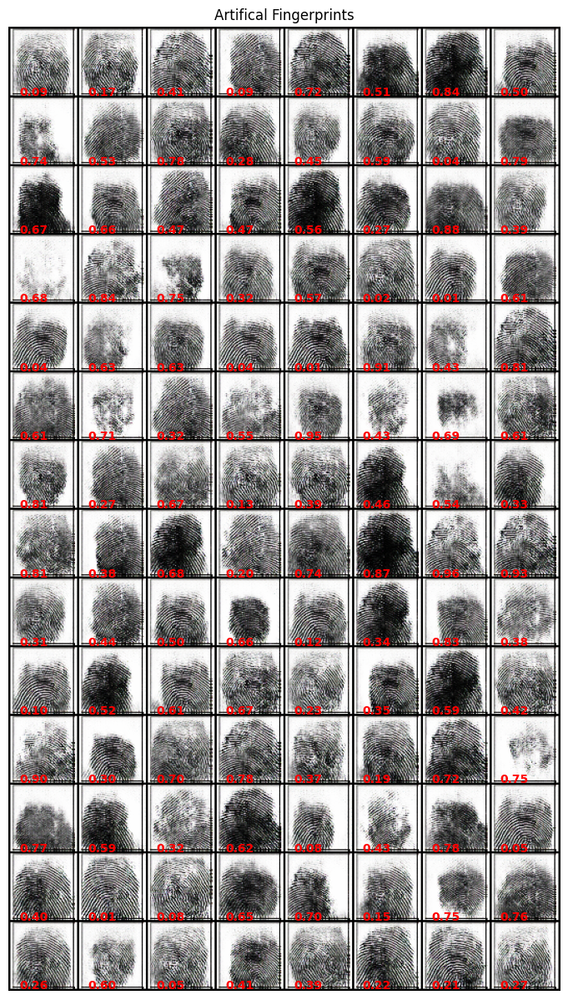

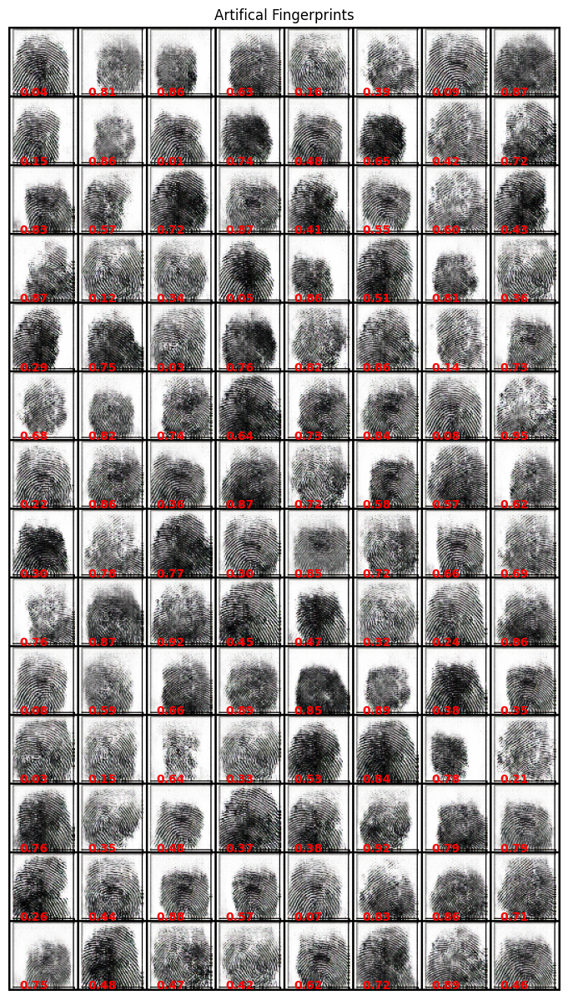

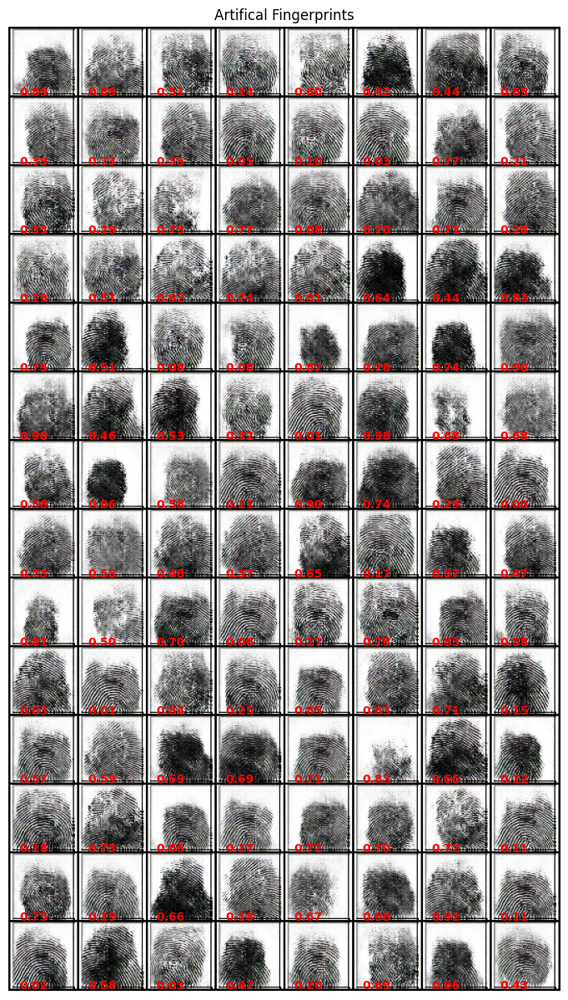

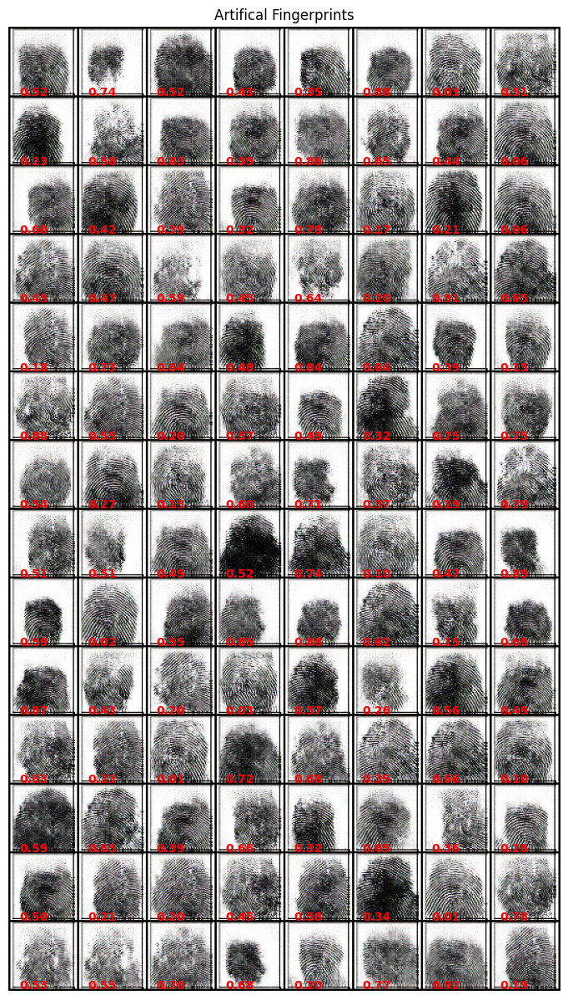

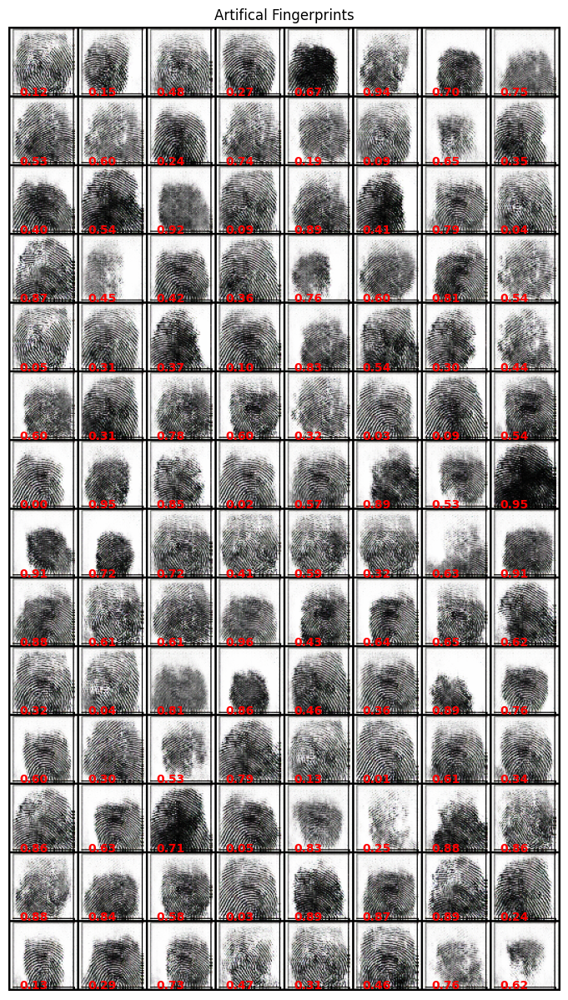

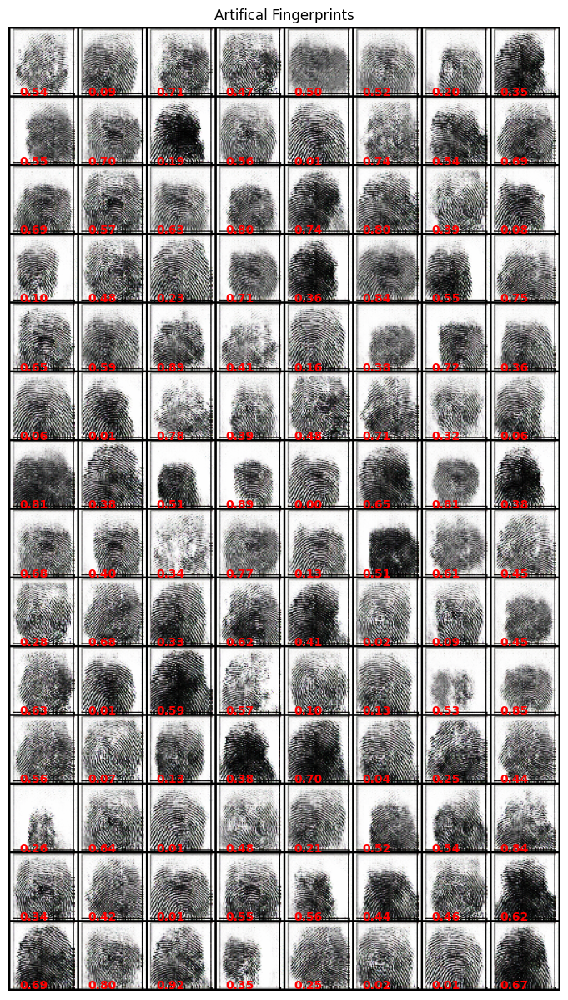

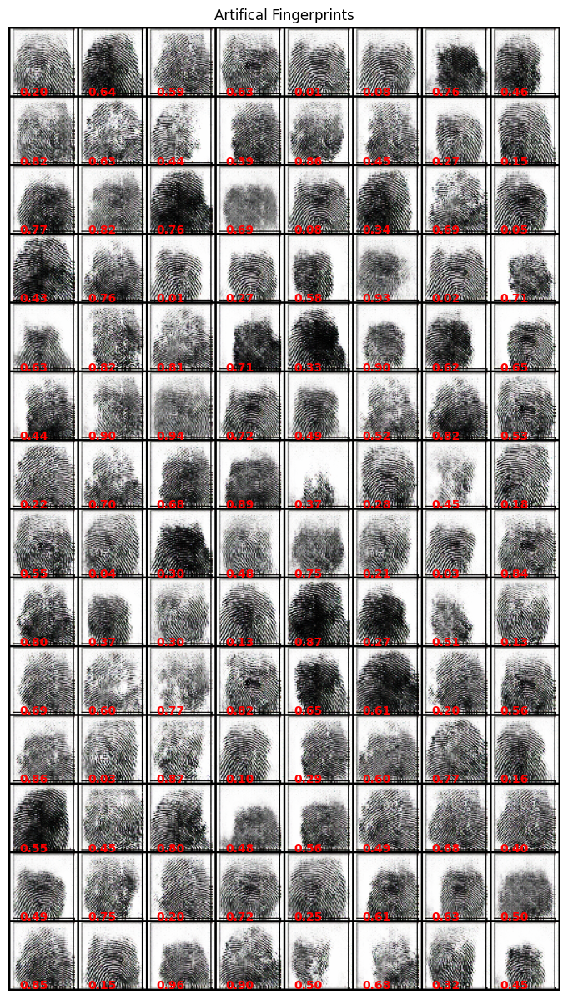

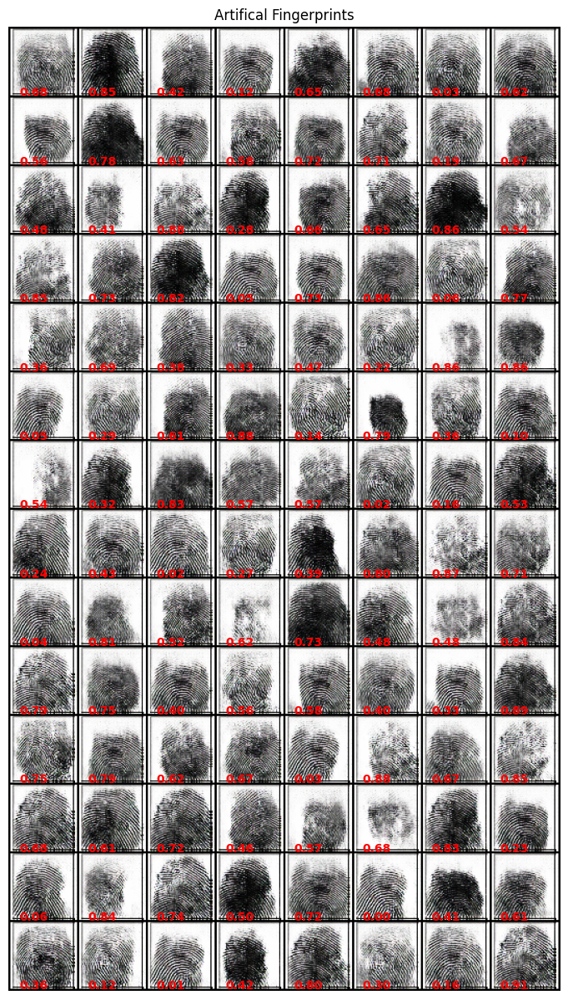

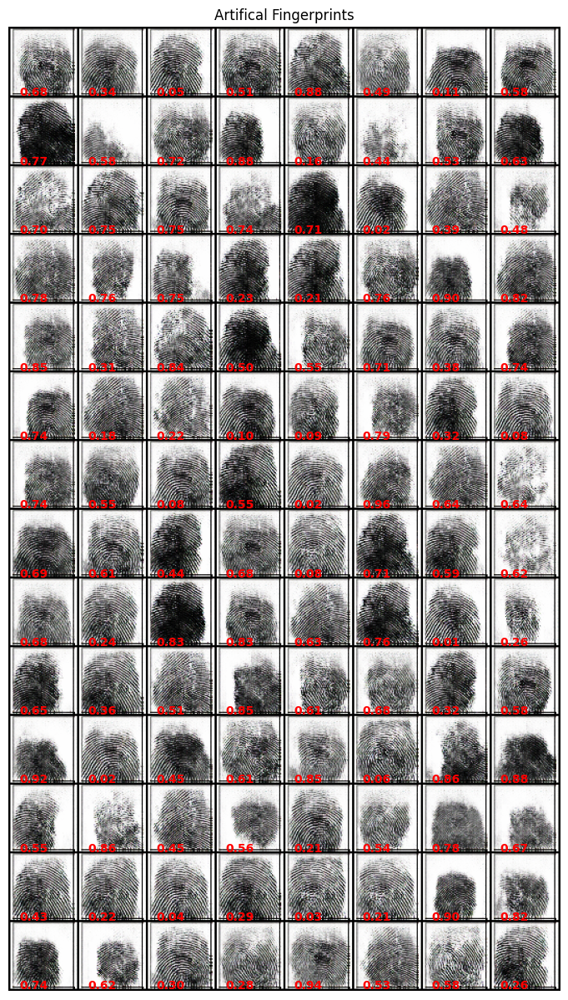

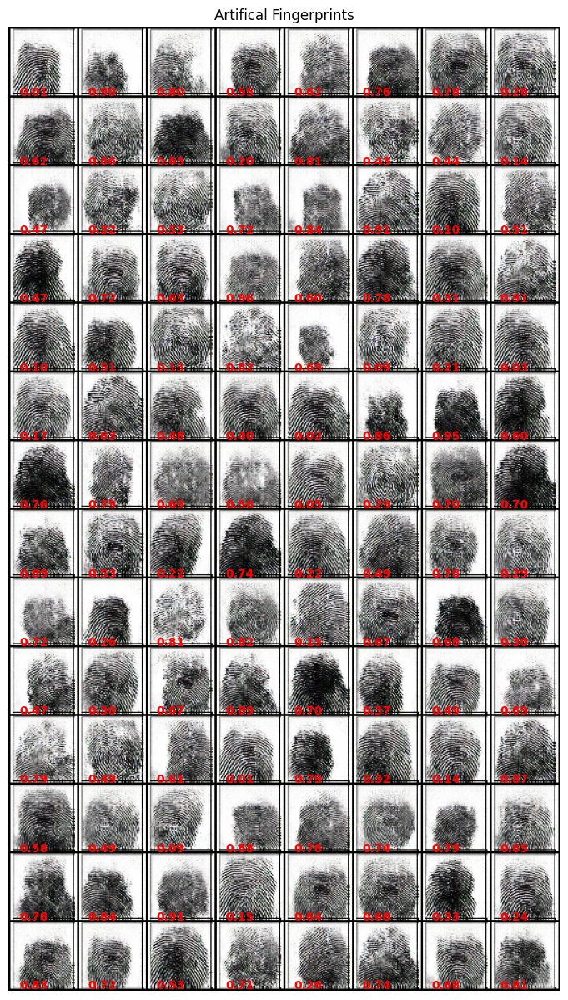

In [ ]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import time

def unpack(t):
    s = []
    for i in t:
        s.append(i[0][0][0])
    return s

SEED = 1234
random.seed(SEED)
torch.manual_seed(SEED)

# path to training images
dataroot = "/content/GAN_Project/data"

# training batch size
batch_size = 128

# image dimension pixels
image_size = 64

# color channels
nc = 3

# latent vector size for generator input
nz = 100

# feature size generator
ngf = 64

# feature size discriminator
ndf = 64

# training runs ("epochs")
num_epochs = 25

# learning rate, from paper
lr = 0.0002

# param for Adam optimizer
beta1 = 0.5

# initializes weights per DCGAN paper
def init_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class Generator(nn.Module):
    """
    Helper class for the generator module

    We have four convolutional stages, with normalizations between each
    Individual kernels are 4x4, with other dimensions/strides scaled
    accordingly.

    The rectified linear activation function ReLU allows fast training while
    avoiding problems associated with sigmoids, etc (vanishing gradients)
    The final application of tanh maps the output to [-1, 1] like our
    normalized input images.
    """
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # Input to convolution stage
            # intermediate state (ngf*8) x 4 x 4
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(True),
            # intermediate state (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(True),
            # intermediate state (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
            # intermediate state ngff x 32 x 32
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh(),
            # output state 64 x 64
        )

    def forward(self, inp):
        """
        Feed input data forward to produce an output image
        """
        return self.main(inp)


class Discriminator(nn.Module):
    """
    helper class for the discriminator module

    This operates similarly to the generator, except that now we are
    convolving with the current weights working toward a value judgement at
    the end.
    """
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input size 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state ndf x 32 x 32
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state (ndf*2) x 16 x 16
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state (ndf*4) x 8 x 8
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2, inplace=True),
            # intermediate state (ndf*8) x 4 x 4
            nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, inp):
        """
        Feed input data forward to produce an output classification
        """
        return self.main(inp)

# Data marshalling helpers
dataset = dset.ImageFolder(root=dataroot,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
    ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
shuffle=True, num_workers=2)

device = torch.device("cpu")

# Set up networks
generator = Generator().to(device)
discriminator = Discriminator().to(device)
discriminator.apply(init_weights)

# Set up feedback optimizers
criterion = nn.BCELoss()

real_label = 1
fake_label = 0

optimizerD = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG= optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))

state = torch.load('networkStates.pyt')
discriminator.load_state_dict(state['discriminator_state_dict'])
optimizerD.load_state_dict(state['optimizerD_state_dict'])
generator.load_state_dict(state['generator_state_dict'])
optimizerG.load_state_dict(state['optimizerG_state_dict'])


img = []
G_conf = []
imageIndex = 0

print("Training discriminator...")
start = time.time()
# Train discriminator with known good data
for i, data in enumerate(dataloader, 0):

    # zero out gradients
    discriminator.zero_grad()

    # prepare a batch
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    # label = torch.full((b_size,), real_label, device=device)
    label=torch.full((b_size,), real_label, device=device, dtype=torch.float)
    # feed forward
    output = discriminator(real_cpu).view(-1)

    # compute error and backpropagate
    errD = criterion(output, label)
    errD.backward()

    optimizerD.step()


print(f"Training complete ( {time.time() - start:.2f} seconds)")
print("Generating and testing fakes...")
# Prepare a batch of fingerprints and evaluate
for i in range(10):

    noise = torch.randn(b_size, nz, 1, 1, device=device)

    with torch.no_grad():
        fake = generator(noise).detach().cpu()
        img.append(vutils.make_grid(fake, padding=2, normalize=True))
        output = discriminator(fake)
        avg = output.view(-1).mean().item()
        confidences = unpack(output.tolist())
        for j, im in enumerate(fake):
            if confidences[j] > 0.9:
                vutils.save_image(im, f"demo_{imageIndex}_{confidences[j]:.2f}.bmp")
                imageIndex += 1
        G_conf.append(confidences)

# Display the images
for i in range(10):
    plt.figure(figsize=(15,15))
    plt.axis("off")
    plt.title("Artifical Fingerprints")
    plt.imshow(np.transpose(img[i],(1,2,0)))
    yoffset = 0
    xoffset = 0
    for j in range(len(G_conf[i])):
        if j % 8 == 0:
            yoffset += 66
            xoffset = 0
        plt.text(10 + xoffset, yoffset, f"{G_conf[i][j]:.2f}", color='red', weight='bold')
        xoffset += 66
    plt.show()

# animate images development in generator
#fig  = plt.figure(figsize=(8,8))
#plt.axis("off")
#ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img]
#ani = animation.ArtistAnimation(fig, ims, interval=1000,repeat_delay=1000,blit=True)
#HTML(ani.to_jshtml())

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import shutil
import os

local_generated_folder = "GAN_Project/generated_images"

drive_folder = "/content/drive/MyDrive/generated_images/"

os.makedirs(drive_folder, exist_ok=True)

shutil.copytree(local_generated_folder, drive_folder, dirs_exist_ok=True)

print(f"Images have been saved to: {drive_folder}")

Images have been saved to: /content/drive/MyDrive/generated_images/
